In [7]:
import heist
import helpers
import torch.distributions
import torch
import torch.nn as nn


import gym
import random
import numpy as np
from helpers import generate_action, load_model
from procgen import ProcgenGym3Env
import imageio
import matplotlib.pyplot as plt
import itertools
import typing
import math
from IPython.display import Image, display


from procgen import ProcgenGym3Env
import struct
import typing
from typing import Tuple, Dict, Callable, List, Optional
from dataclasses import dataclass
from src.policies_modified import ImpalaCNN
from procgen_tools.procgen_wrappers import VecExtractDictObs, TransposeFrame, ScaledFloatFrame

from gym3 import ToBaselinesVecEnv

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:


def create_activation_dataset(dataset, model, layer_paths):
    activation_dataset = {
        "gem": [],
        "blue_key": [],
        "green_key": [],
        "red_key": [],
        "blue_lock": [],
        "green_lock": [],
        "red_lock": []
    }

    for category in dataset:
        for obs in dataset[category]:
            obs_rgb = helpers.observation_to_rgb(obs)
            model_activations = helpers.ModelActivations(model)
            _, activations = model_activations.run_with_cache(obs_rgb, layer_paths)
            model_activations.clear_hooks()


            activation_dataset[category].append(activations)

    return activation_dataset







In [9]:
#Create dataset for probes
dataset = heist.create_classified_dataset(num_samples_per_category=400)


In [12]:
# Create classified dataset

# Load the model
model = load_model()

layer_names = [name for name, _ in model.named_modules() if isinstance(_, nn.Module)]
layer_names = layer_names[1:len(layer_names)]
print(layer_names)

# Create activation dataset, which is a dictionary with labels "gem", and activations as a list
# objective name, sample number, layer, stored as tuple
activation_dataset = create_activation_dataset(dataset, model, layer_names)

['conv_seqs', 'conv_seqs.0', 'conv_seqs.0.conv', 'conv_seqs.0.max_pool2d', 'conv_seqs.0.res_block0', 'conv_seqs.0.res_block0.conv0', 'conv_seqs.0.res_block0.conv1', 'conv_seqs.0.res_block1', 'conv_seqs.0.res_block1.conv0', 'conv_seqs.0.res_block1.conv1', 'conv_seqs.1', 'conv_seqs.1.conv', 'conv_seqs.1.max_pool2d', 'conv_seqs.1.res_block0', 'conv_seqs.1.res_block0.conv0', 'conv_seqs.1.res_block0.conv1', 'conv_seqs.1.res_block1', 'conv_seqs.1.res_block1.conv0', 'conv_seqs.1.res_block1.conv1', 'conv_seqs.2', 'conv_seqs.2.conv', 'conv_seqs.2.max_pool2d', 'conv_seqs.2.res_block0', 'conv_seqs.2.res_block0.conv0', 'conv_seqs.2.res_block0.conv1', 'conv_seqs.2.res_block1', 'conv_seqs.2.res_block1.conv0', 'conv_seqs.2.res_block1.conv1', 'hidden_fc', 'logits_fc', 'value_fc']


In [33]:
# Create contrasting pairs

steering_vec = 0
for i in range(len(activation_dataset)):
    steering_vec += (activation_dataset["blue_key"][0]["hidden_fc"][0]-activation_dataset["blue_lock"][0]["hidden_fc"][0])

steering_vec = steering_vec/len(activation_dataset)



In [25]:
@torch.no_grad()
def generate_action_with_steering(model, observation, steering_vector, is_procgen_env=False):
    observation = torch.tensor(observation, dtype=torch.float32).unsqueeze(0)
    
    # Define the steering hook function
    def steering_hook(module, input, output):
        # Add the steering vector to the output activations
        modified_output = output + steering_vector.unsqueeze(0)
        return modified_output

    # Register the steering hook to the 'hidden_fc' layer
    named_modules_dict = dict(model.named_modules())
    hidden_fc_layer = named_modules_dict['hidden_fc']
    steering_handle = hidden_fc_layer.register_forward_hook(steering_hook)

    # Forward pass with steering
    model_output = model(observation)

    # Remove the steering hook
    steering_handle.remove()

    logits = model_output[0].logits  # discard the output of the critic in our actor critic network
    probabilities = torch.softmax(logits, dim=-1)
    action = torch.multinomial(probabilities, 1).item()

    if is_procgen_env:
        return np.array([action])
    return action

def run_episode_with_steering_and_save_as_gif(env, model, steering_vector, filepath='../gifs/run.gif', save_gif=False, episode_timeout=200):
    observations = []
    observation = env.reset()
    done = False
    total_reward = 0
    frames = []
    count = 0

    while not done:
        if save_gif:
            frames.append(env.render(mode='rgb_array'))

        action = generate_action_with_steering(model, observation, steering_vector, is_procgen_env=False)

        # Perform inference with the model one step
        observation, reward, done, info = env.step(action)
        total_reward += reward
        observations.append(observation)
        count += 1

        if count >= episode_timeout:
            break

    if save_gif:
        imageio.mimsave(filepath, frames, fps=30)

    return total_reward, frames, observations

In [112]:
model = load_model()

# Create environment and load model

venv = heist.create_venv(1,0,100)

# obs = venv.reset()
# # Transpose the data to (height, width, channels)
# helpers.plot_single_observation(obs.squeeze().transpose(1,2,0))
total_reward, frames, observations2 = helpers.run_episode_with_steering_and_save_as_gif(venv, model, -1*steering_vec, filepath=f'episode_steering.gif', save_gif=True,  episode_timeout=50, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")

_ = venv.reset()

total_reward, frames, observations = helpers.run_episode_and_save_as_gif(venv, model, filepath=f'episode.gif', save_gif=True,  episode_timeout=50, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")


Saved gif!
Episode finished with total reward: [0.]
Episode finished with total reward: [0.]


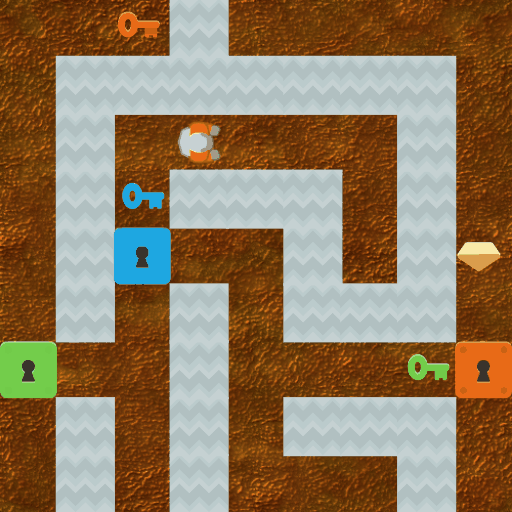

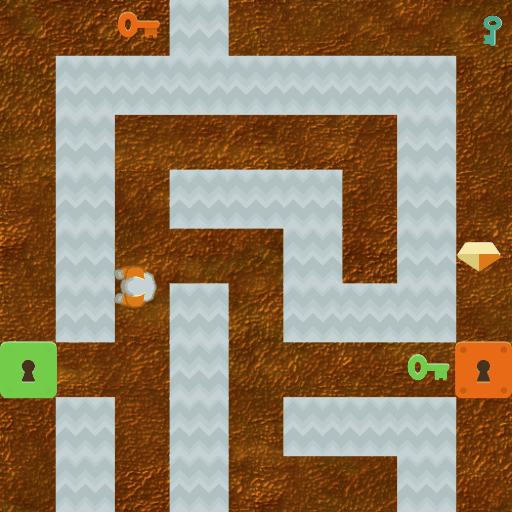

In [113]:
# Display an image file from local storage
display(Image(filename='episode_steering.gif', width=250, height=250))
display(Image(filename='episode.gif',width=250, height=250))

OLD

In [ ]:
import torch
import numpy as np
import imageio

@torch.no_grad()
def generate_action_with_steering(model, observation, steering_vectors, is_procgen_env=False):
    observation = torch.tensor(observation, dtype=torch.float32).unsqueeze(0)

    # Define the steering hook function
    def steering_hook(module_name):
        def hook(module, input, output):
            if module_name in steering_vectors:
                # Add the steering vector to the output activations
                steering_vector = steering_vectors[module_name]
                modified_output = output + steering_vector.unsqueeze(0)
                return modified_output
            return output
        return hook

    # Register the steering hooks to all layers specified in the steering_vectors dictionary
    handles = []
    for name, module in model.named_modules():
        if name in steering_vectors:
            handle = module.register_forward_hook(steering_hook(name))
            handles.append(handle)

    # Forward pass with steering
    model_output = model(observation)

    # Remove all steering hooks
    for handle in handles:
        handle.remove()

    logits = model_output[0].logits  # discard the output of the critic in our actor critic network
    probabilities = torch.softmax(logits, dim=-1)
    action = torch.multinomial(probabilities, 1).item()

    if is_procgen_env:
        return np.array([action])
    return action

def run_episode_with_steering_and_save_as_gif(env, model, steering_vectors, filepath='../gifs/run.gif', save_gif=False, episode_timeout=200):
    observations = []
    observation = env.reset()
    done = False
    total_reward = 0
    frames = []
    count = 0

    while not done:
        if save_gif:
            frames.append(env.render(mode='rgb_array'))

        action = generate_action_with_steering(model, observation, steering_vectors, is_procgen_env=False)

        # Perform inference with the model one step
        observation, reward, done, info = env.step(action)
        total_reward += reward
        observations.append(observation)
        count += 1

        if count >= episode_timeout:
            break

    if save_gif:
        imageio.mimsave(filepath, frames, fps=30)

    return total_reward, frames, observations


In [ ]:
# Run model through episode with steering
# Next step is to patch the objective vectors back into the network during a forward pass and see how they affect the network

# Define the weights for each objective (you can experiment with different values)
objective_weights = {
    "gem": 0,
    "blue_key": 0,
    "green_key": 0,
    "red_key": 0,
    "blue_lock": 0,
    "green_lock": 0,
    "red_lock": 0
}

# Create a linear combination of average activation vectors
steering_vector = sum(objective_weights[obj] * objective_vectors[obj] for obj in objective_vectors)

model = load_model(model_path='../model_vivid_feather_latest.pt')

# Create environment and load model

venv = heist.create_venv(1,0,0)

# obs = venv.reset()
# # Transpose the data to (height, width, channels)
# helpers.plot_single_observation(obs.squeeze().transpose(1,2,0))
total_reward, frames, observations2 = helpers.run_episode_with_steering_and_save_as_gif(venv, model, steering_vector, filepath=f'episode_steering.gif', save_gif=True,  episode_timeout=100, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")

_ = venv.reset()



total_reward, frames, observations = helpers.run_episode_and_save_as_gif(venv, model, filepath=f'episode.gif', save_gif=True,  episode_timeout=100, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")




# Display an image file from local storage
# display(Image(filename='episode_steering.gif'))
# display(Image(filename='episode.gif'))


Saved gif!
Episode finished with total reward: [0.]
Episode finished with total reward: [0.]


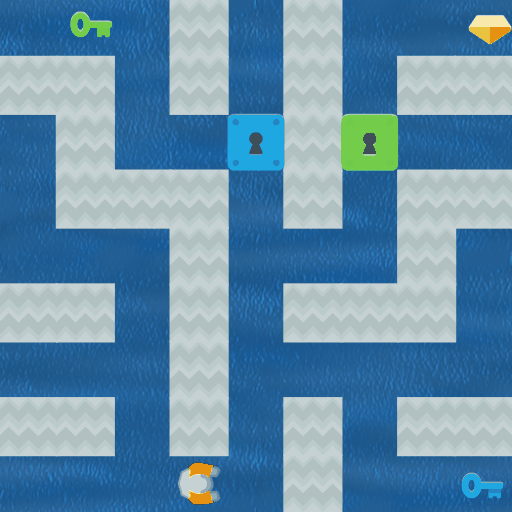

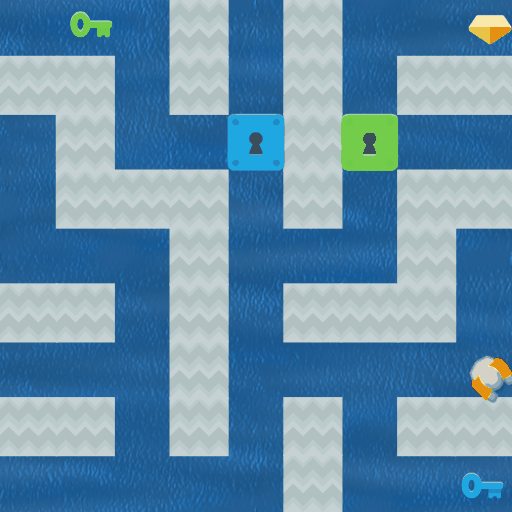

In [ ]:
# Display an image file from local storage
display(Image(filename='episode_steering.gif'))
display(Image(filename='episode.gif'))

In [ ]:
def create_direction_activation_dataset(dataset, model, layer_paths):
    activation_dataset = {
        "top_left": [],
        "top_right": [],
        "bottom_left": [],
        "bottom_right": []
    }

    for category in dataset:
        for obs in dataset[category]:
            obs_rgb = helpers.observation_to_rgb(obs)
            model_activations = ModelActivations(model)
            _, activations = model_activations.run_with_cache(obs_rgb, layer_paths)
            model_activations.clear_hooks()


            activation_dataset[category].append(activations)

    return activation_dataset

model = helpers.load_model(model_path="../model_501_copper_wave.pt")
dataset = heist.create_direction_dataset(100)
layer_names = helpers.get_model_layer_names(model)
activation_dataset = create_direction_activation_dataset(dataset, model, layer_names)

In [ ]:
direction_vectors = {}
for key in activation_dataset.keys():
    direction_vector = 0
    for i in range(len(activation_dataset[key])):
        direction_vector += activation_dataset[key][i]['hidden_fc'][0]
    direction_vectors[key] = direction_vector/len(activation_dataset[key])

In [ ]:
# Run model through episode with steering
# Next step is to patch the objective vectors back into the network during a forward pass and see how they affect the network

# Define the weights for each objective (you can experiment with different values)
direction_weights = {
        "top_left": 0,
        "top_right": 0,
        "bottom_left": 0,
        "bottom_right": 10
    
}

# Create a linear combination of average activation vectors
steering_vector = sum(direction_weights[obj] * direction_vectors[obj] for obj in direction_vectors)

model = load_model(model_path="../model_vivid_feather_latest.pt")


# Create environment and load model

# venv = heist.create_venv(1,1,20)

# obs = venv.reset()
# # Transpose the data to (height, width, channels)
# helpers.plot_single_observation(obs.squeeze().transpose(1,2,0))
total_reward, frames, observations2 = helpers.run_episode_with_steering_and_save_as_gif(venv, model, steering_vector, filepath=f'episode_steering.gif', save_gif=True,  episode_timeout=200, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")

total_reward, frames, observations = helpers.run_episode_and_save_as_gif(venv, model, filepath=f'episode.gif', save_gif=True,  episode_timeout=200, is_procgen_env=True)
print(f"Episode finished with total reward: {total_reward}")
_ = venv.reset()



# # # Display an image file from local storage
# display(Image(filename='episode_steering.gif'))
# display(Image(filename='episode.gif'))


In [ ]:
model = load_model(model_path="../model_vivid_feather_latest.pt")
venv = heist.create_venv(1,10,1000)

for i in range(10):
    total_reward, frames, observations = helpers.run_episode_and_save_as_gif(venv, model, filepath=f'episode.gif', save_gif=False,  episode_timeout=500, is_procgen_env=True)
    print(f"Episode finished with total reward: {total_reward}")
    # helpers.plot_single_observation(observations[0].squeeze())


Episode finished with total reward: [10.]
Episode finished with total reward: [10.]
Episode finished with total reward: [10.]
Episode finished with total reward: [10.]
Episode finished with total reward: [0.]
Episode finished with total reward: [0.]
Episode finished with total reward: [10.]
Episode finished with total reward: [10.]
Episode finished with total reward: [0.]
Episode finished with total reward: [0.]
